In [99]:
import os
from glob import glob
import pandas as pd
import numpy as np
import dask.dataframe as dd
import matplotlib.pyplot as plt

from matplotlib import font_manager, rc
font_path = "C:/Windows/Fonts/NGULIM.TTF"
font = font_manager.FontProperties(fname=font_path).get_name()
rc('font', family=font)

* 불러오기

In [20]:
path = os.getcwd()
site_list = sorted(glob(os.path.join(path,"data","sensing_data","*")))
site_list = list(map(os.path.basename,site_list))
print(path)
print(site_list)

c:\Users\Go\OneDrive - UOS\allrepos\research_workspace\어린이집데이터_eda
['남부', '동화나라', '소리엘', '솜사탕', '예나']


In [54]:
%%time
csv_by_site = []
for i in site_list:
    print(i)
    structure = sorted(glob(os.path.join(path,"data","sensing_data",i,'*')))
    structure = list(map(os.path.basename,structure))
    for j in structure:
        _ = dd.read_csv(os.path.join(path,"data","sensing_data",i,j),encoding='cp949').compute()
        _['site'] = i
        _['site_details'] = j
        csv_by_site.append(_)

data = pd.concat(csv_by_site)
data['T/D'] = pd.to_datetime(data['T/D'])
data.set_index('T/D',inplace=True)
data.columns = ['index','temp','hum','pm1','pm2.5','pm4','pm10','co2','tvoc','site','site_details']
data = data[['temp','hum','pm1','pm2.5','pm4','pm10','co2','tvoc','site','site_details']]


남부
동화나라
소리엘
솜사탕
예나
Wall time: 14 s


In [106]:
data

,temp,hum,pm1,pm2.5,pm4,pm10,co2,tvoc,site,site_details
T/D,,,,,,,,,,
2021-12-27 17:30:20,16.021,39.916,13.060,14.826,15.649,15.813,975.243,0,남부,남부_거실.csv
2021-12-27 17:30:30,16.168,39.906,13.067,14.804,15.601,15.761,979.463,0,남부,남부_거실.csv
2021-12-27 18:16:30,22.679,24.140,12.396,13.441,13.711,13.765,940.974,0,남부,남부_거실.csv
2021-12-27 18:16:40,22.697,23.539,11.745,12.708,12.941,12.988,953.258,0,남부,남부_거실.csv
2021-12-27 18:16:50,22.710,23.429,11.028,11.930,12.146,12.190,961.798,0,남부,남부_거실.csv
...,...,...,...,...,...,...,...,...,...,...
2022-03-25 17:00:00,27.651,38.672,8.829,9.421,9.489,9.503,1864.594,0,예나,예나_부엌.csv
2022-03-25 17:00:10,27.636,38.608,8.946,9.536,9.597,9.609,1864.294,0,예나,예나_부엌.csv
2022-03-25 17:00:20,27.648,38.597,9.420,10.023,10.073,10.083,1863.953,0,예나,예나_부엌.csv


## eda

* 지점별 평균

In [107]:
data.groupby('site').mean()

,temp,hum,pm1,pm2.5,pm4,pm10,co2,tvoc
site,,,,,,,,
남부,18.731111,30.326289,10.774421,11.600295,11.767602,11.801063,742.682617,0.0
동화나라,22.329706,31.916975,15.823071,16.911256,17.056075,17.085038,1754.018211,0.0
소리엘,20.885262,25.864164,11.076868,12.030335,12.286840,12.338143,743.459580,0.0
솜사탕,26.711356,19.992350,11.357138,12.159715,12.281071,12.305344,861.501512,0.0
예나,24.493692,22.762960,13.431013,14.456234,14.661338,14.702359,907.615986,0.0


In [108]:
data.groupby('site_details').mean()

,temp,hum,pm1,pm2.5,pm4,pm10,co2,tvoc
site_details,,,,,,,,
남부_거실.csv,18.861971,24.519444,13.303727,14.358218,14.592931,14.639853,642.070375,0.0
남부_방1.csv,18.212991,33.287947,12.860609,13.864537,14.078920,14.121818,718.806756,0.0
남부_방2.csv,17.254561,38.666885,5.770823,6.194352,6.268732,6.283604,767.224556,0.0
남부_방3.csv,18.441239,31.897463,7.426517,8.019735,8.154446,8.181383,939.539693,0.0
남부_방4.csv,18.316768,30.138557,9.643847,10.426764,10.611882,10.648907,638.523969,0.0
남부_방5.csv,23.440888,20.046724,9.785118,10.487062,10.600074,10.622685,707.157059,0.0
남부_방6.csv,21.410884,22.951216,6.606835,7.090900,7.175392,7.192293,932.001149,0.0
남부_방7.csv,17.315981,22.164312,12.467966,13.531904,13.813116,13.869342,805.563961,0.0
남부_부엌.csv,15.495707,40.808835,18.442347,19.740408,19.933274,19.971846,749.477944,0.0


* 전체 평균(일, 시간)

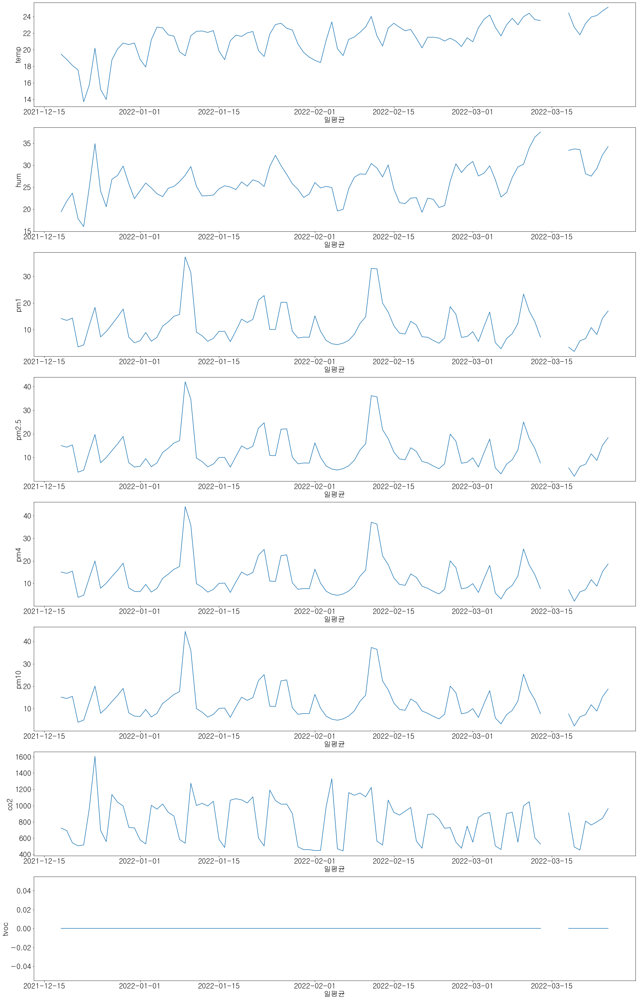

In [117]:
mean_by_date = data.resample('1D').mean()
fig, axes = plt.subplots(len(mean_by_date.columns),1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for i,val in enumerate(mean_by_date.columns):
    axes[i].plot(mean_by_date.loc[:,val])
    axes[i].set_ylabel(val)
    axes[i].set_xlabel("일평균")

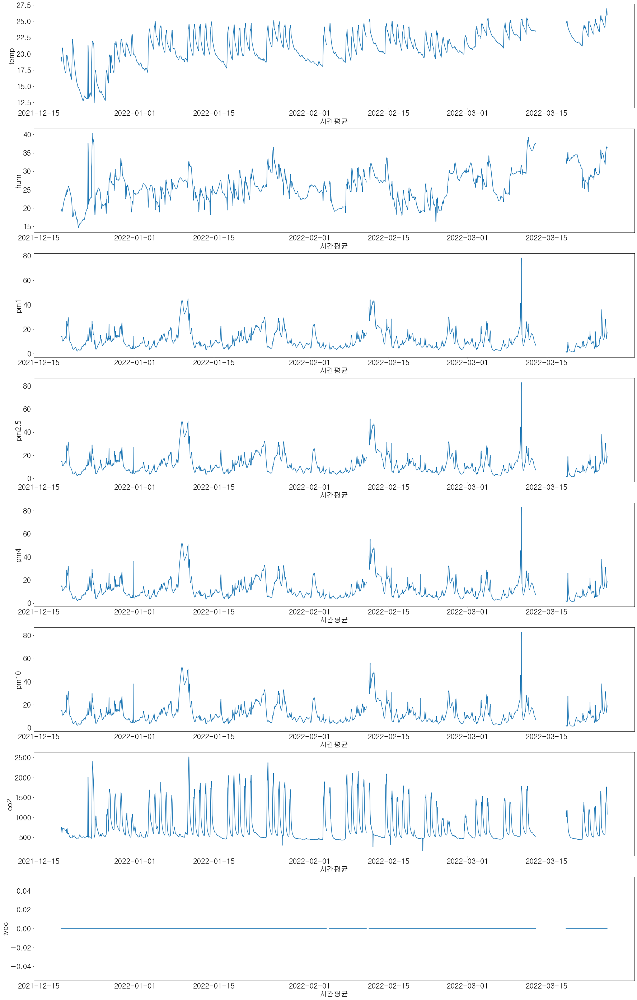

In [131]:
mean_by_time = data.resample('60T',).mean()
fig, axes = plt.subplots(len(mean_by_time.columns),1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for i,val in enumerate(mean_by_time.columns):
    axes[i].plot(mean_by_time.loc[:,val])
    axes[i].set_ylabel(val)
    axes[i].set_xlabel("시간평균")

* 지점별 일평균

Wall time: 35.1 s


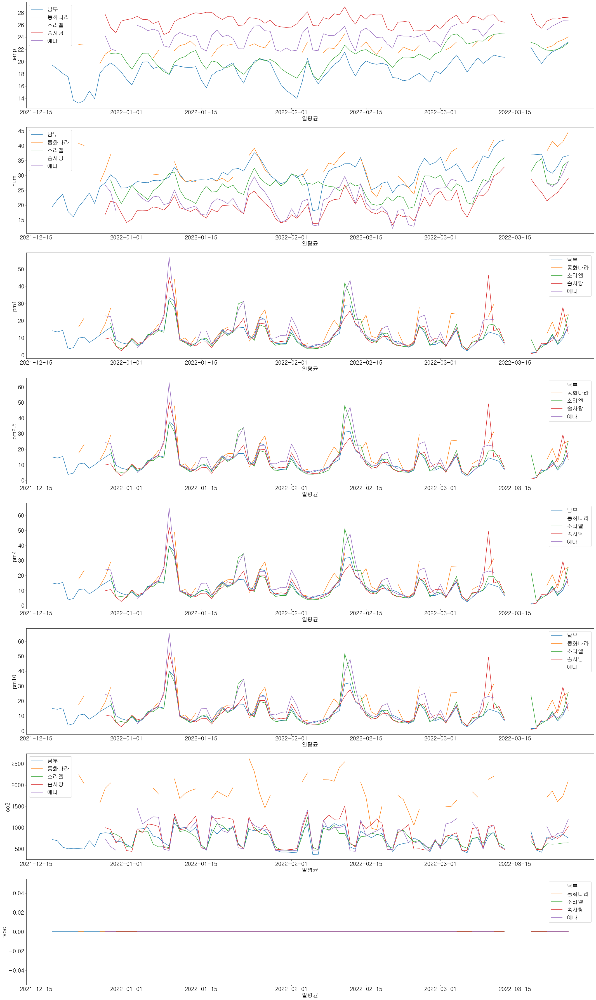

In [155]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(site_list):
        series_data = data[data.site == site_list[i]][[j_val]].resample('1D',).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel("일평균")
fig.tight_layout()


* 지점별 시간평균

Wall time: 35.9 s


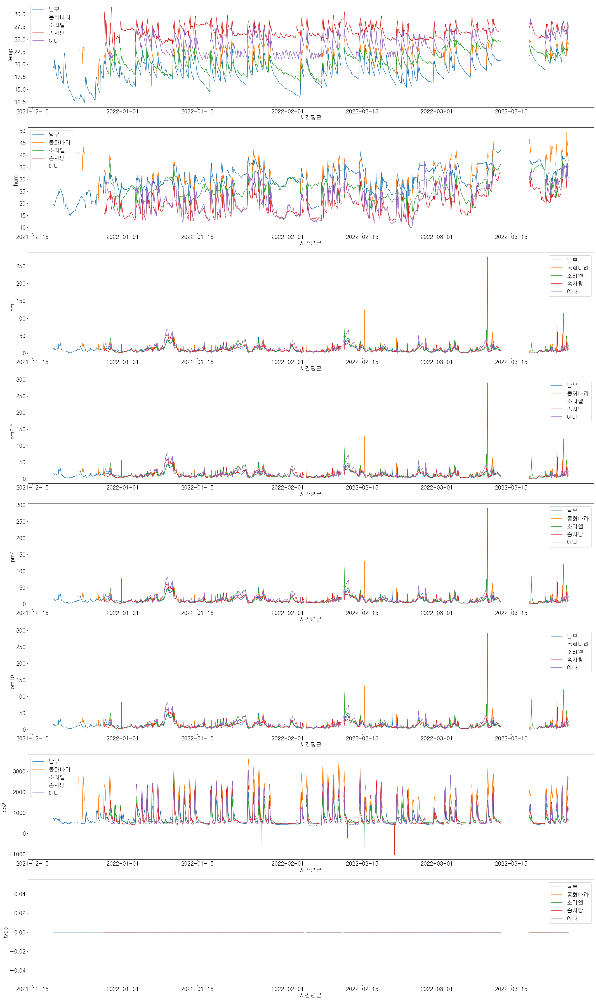

In [156]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(site_list):
        series_data = data[data.site == site_list[i]][[j_val]].resample('60T',).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel("시간평균")
fig.tight_layout()


* 지점별 30분평균

Wall time: 35.2 s


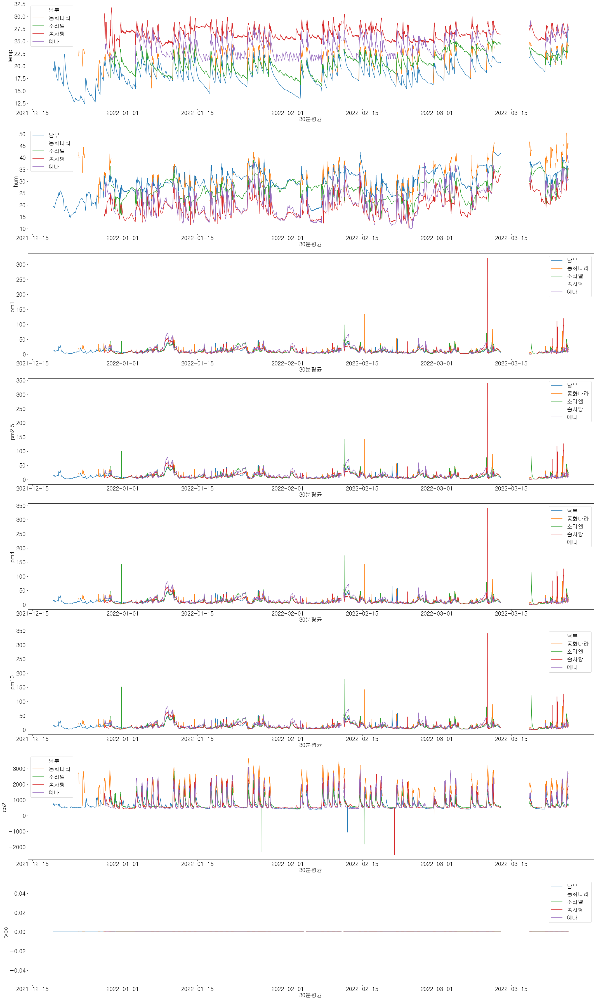

In [159]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(site_list):
        series_data = data[data.site == site_list[i]][[j_val]].resample('30T',).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel("30분평균")
fig.tight_layout()


* 지점별 5분평균

Wall time: 35.2 s


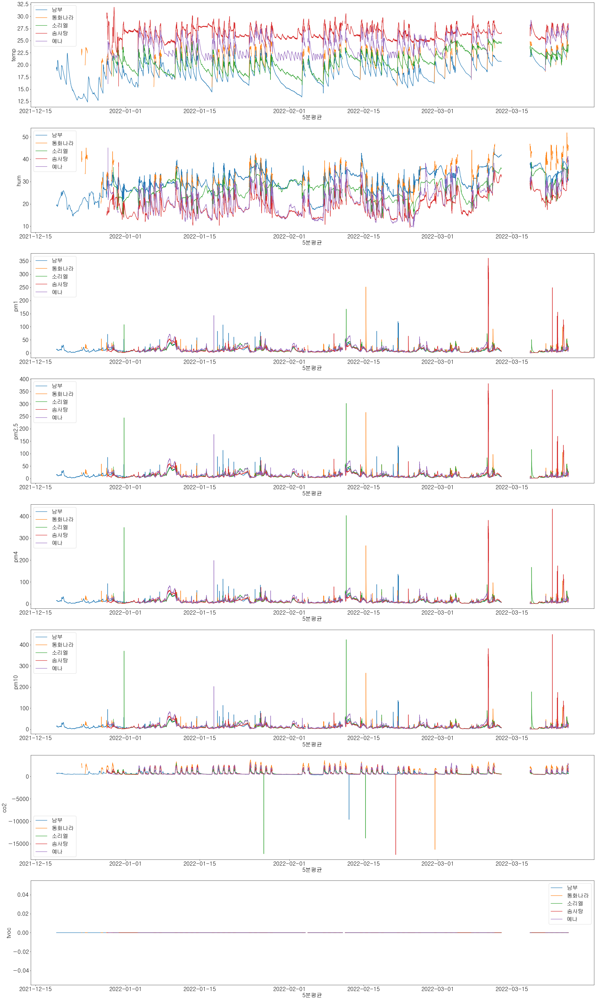

In [160]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(site_list):
        series_data = data[data.site == site_list[i]][[j_val]].resample('5T',).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel("5분평균")
fig.tight_layout()


* 타임레그별 비교

Wall time: 59.2 s


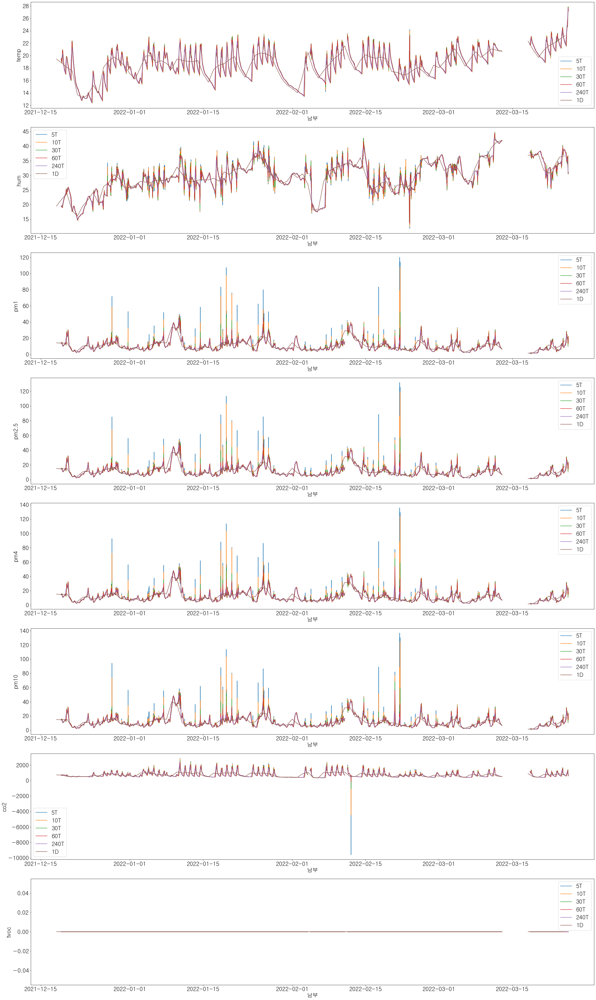

In [164]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '남부'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = data[data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 29.6 s


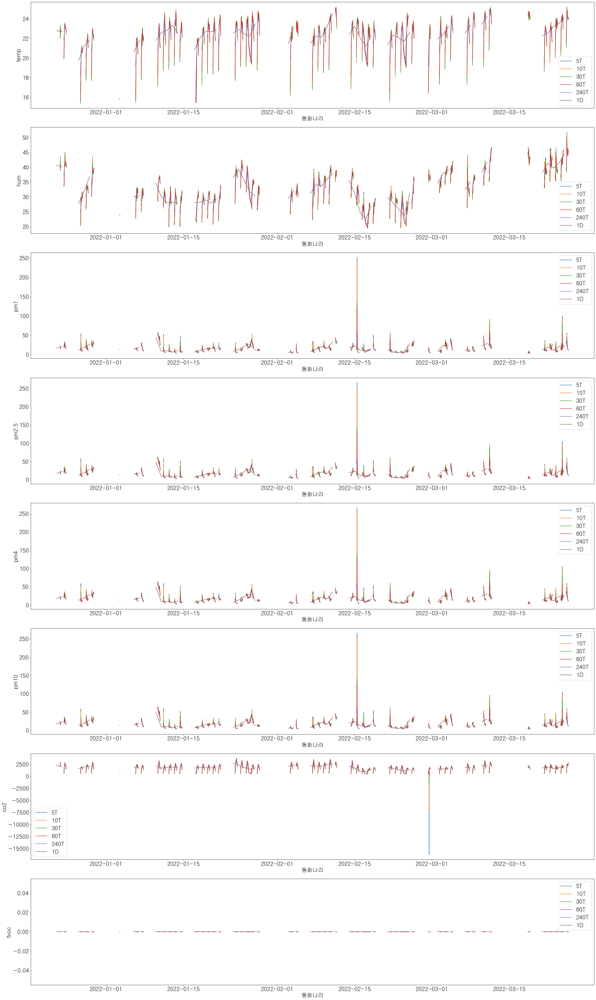

In [165]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '동화나라'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = data[data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 49.3 s


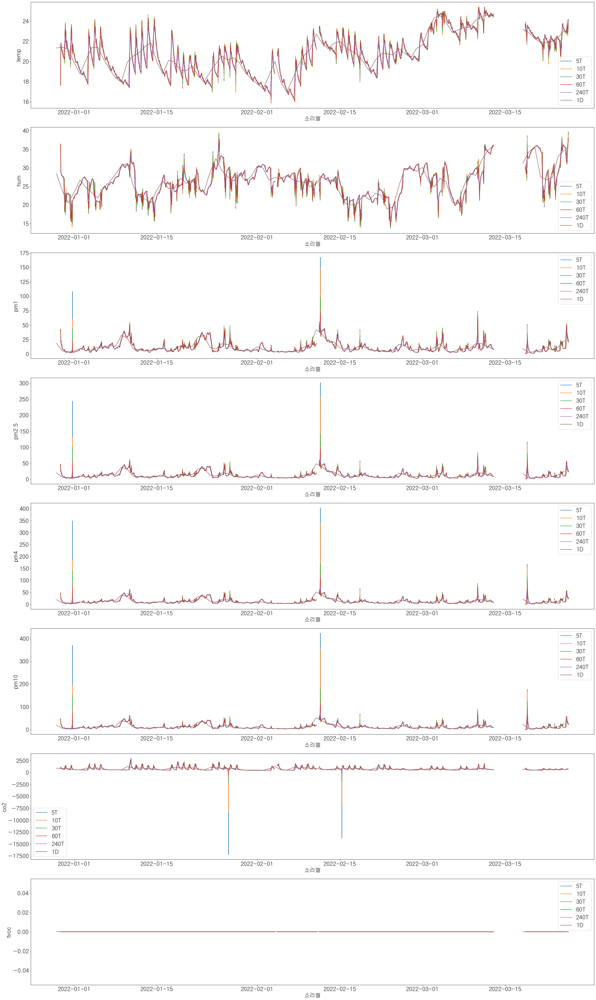

In [166]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '소리엘'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = data[data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 42.7 s


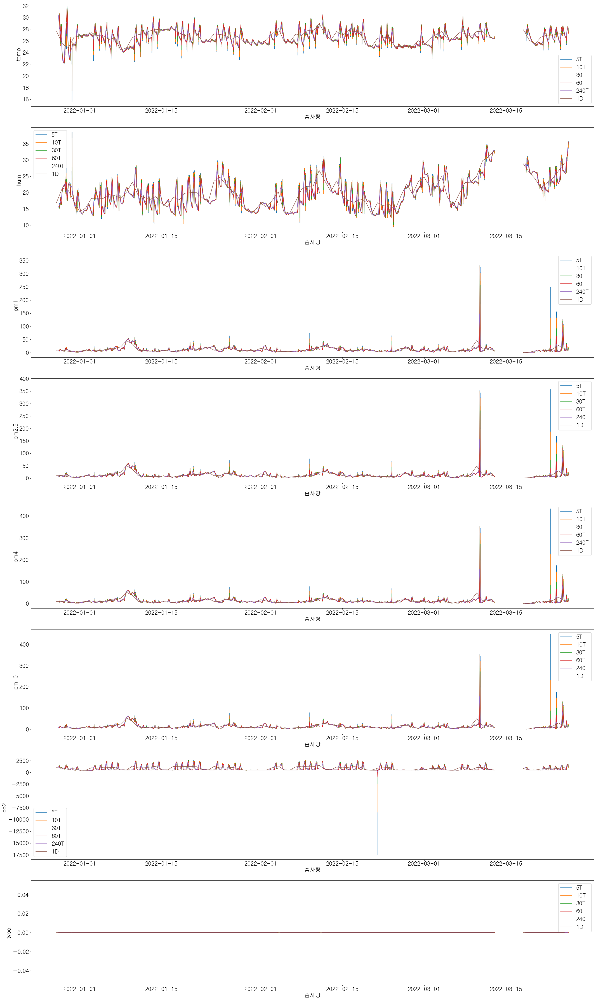

In [167]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = data[data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 41.4 s


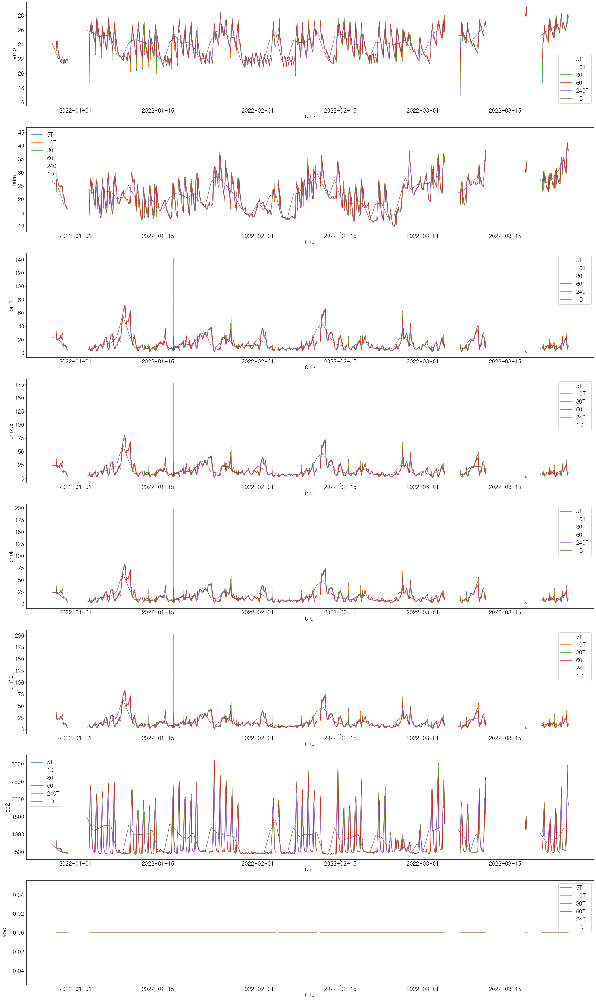

In [168]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '예나'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = data[data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


* 2022년 3월 1~2주차

Wall time: 17.6 s


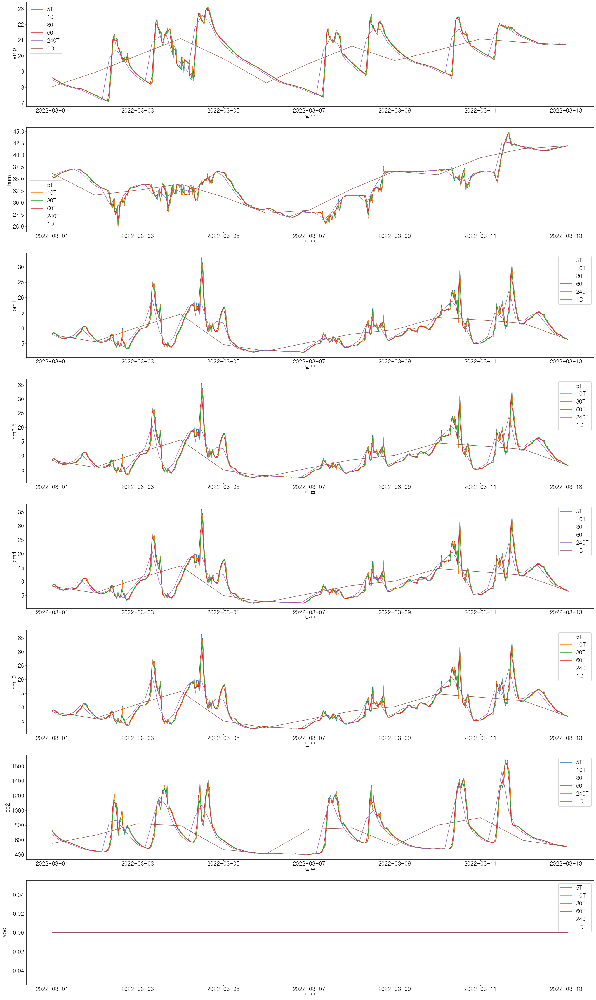

In [174]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '남부'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]

period_data = data.loc['2022-03-01':'2022-03-14']

for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 14.6 s


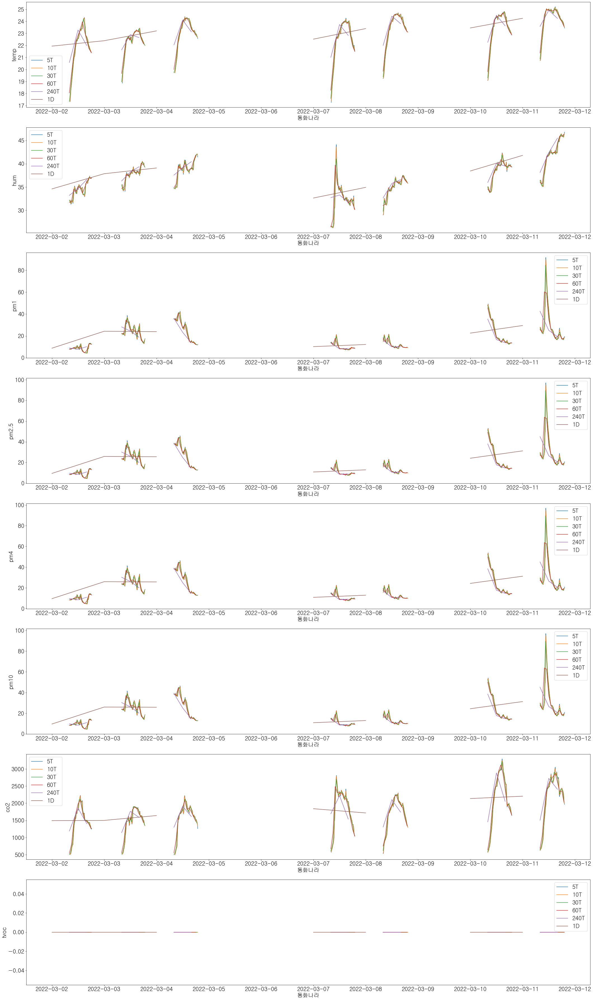

In [175]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '동화나라'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]

period_data = data.loc['2022-03-01':'2022-03-14']

for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 17.6 s


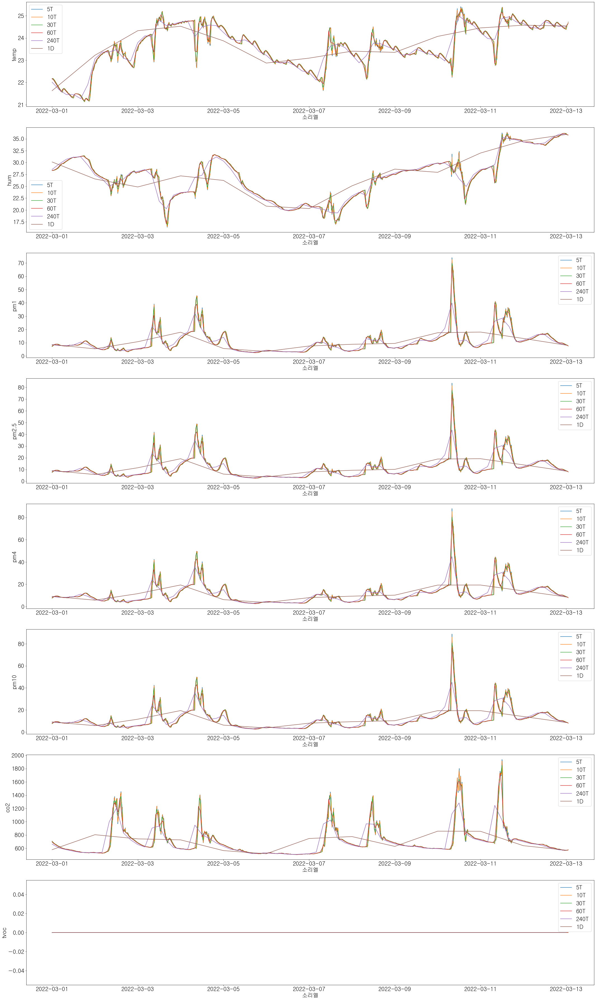

In [176]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '소리엘'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]

period_data = data.loc['2022-03-01':'2022-03-14']

for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 16.6 s


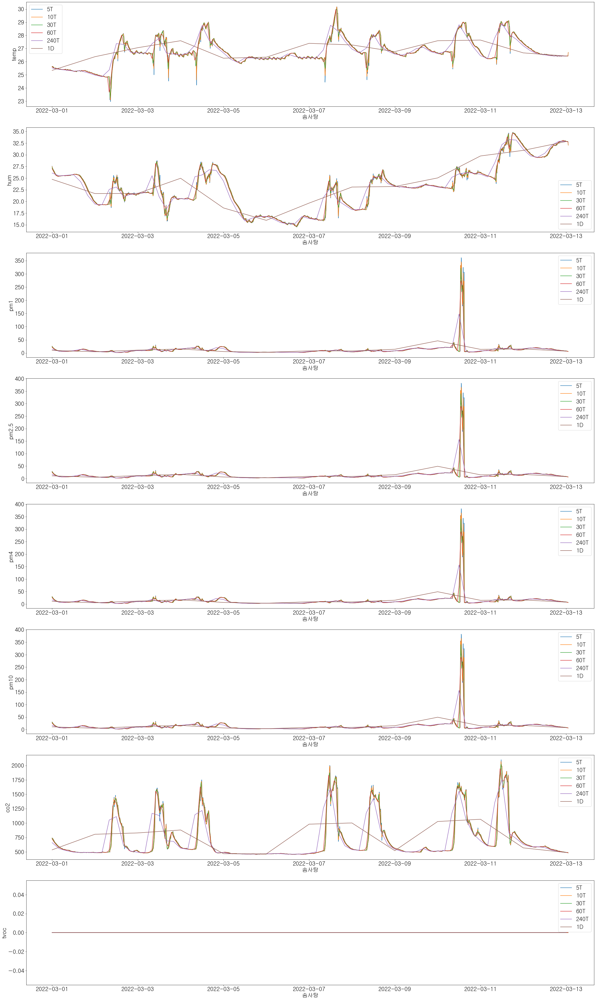

In [177]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-01':'2022-03-14']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 15.9 s


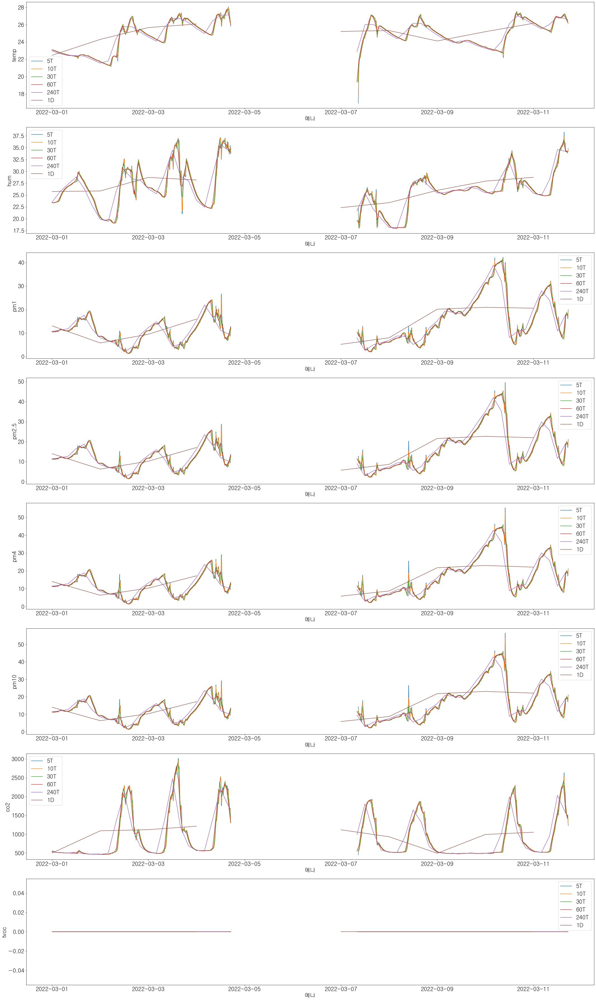

In [178]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '예나'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-01':'2022-03-14']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


* 2022년 3월 2일~3일

Wall time: 1.98 s


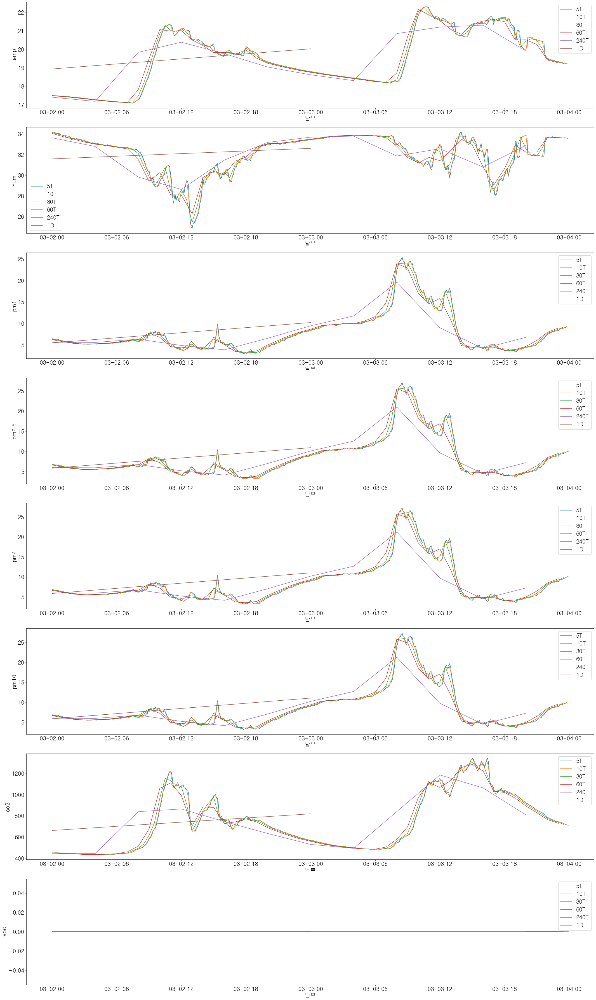

In [180]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '남부'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-3']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 1.36 s


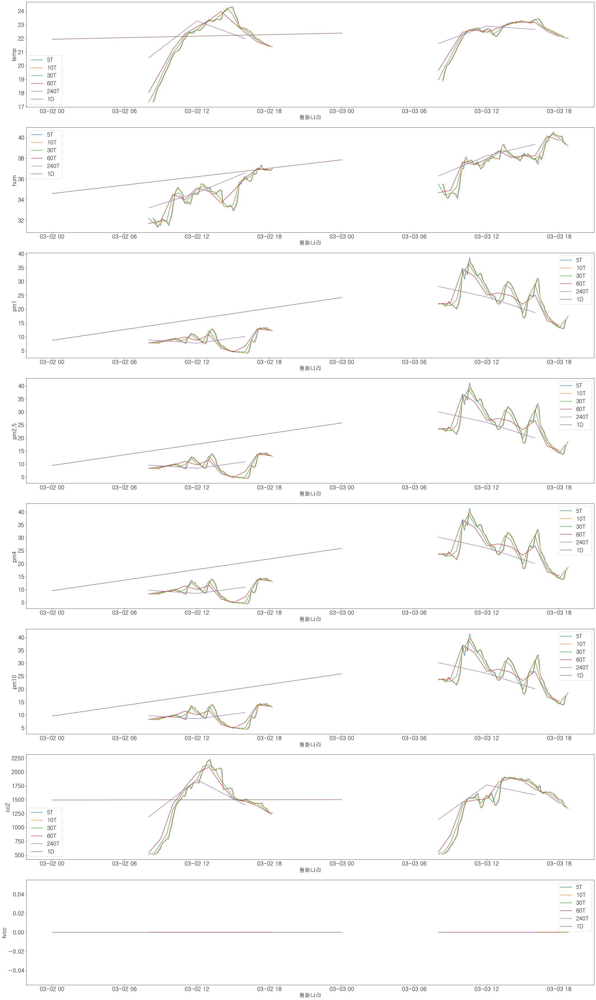

In [181]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '동화나라'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-3']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 1.97 s


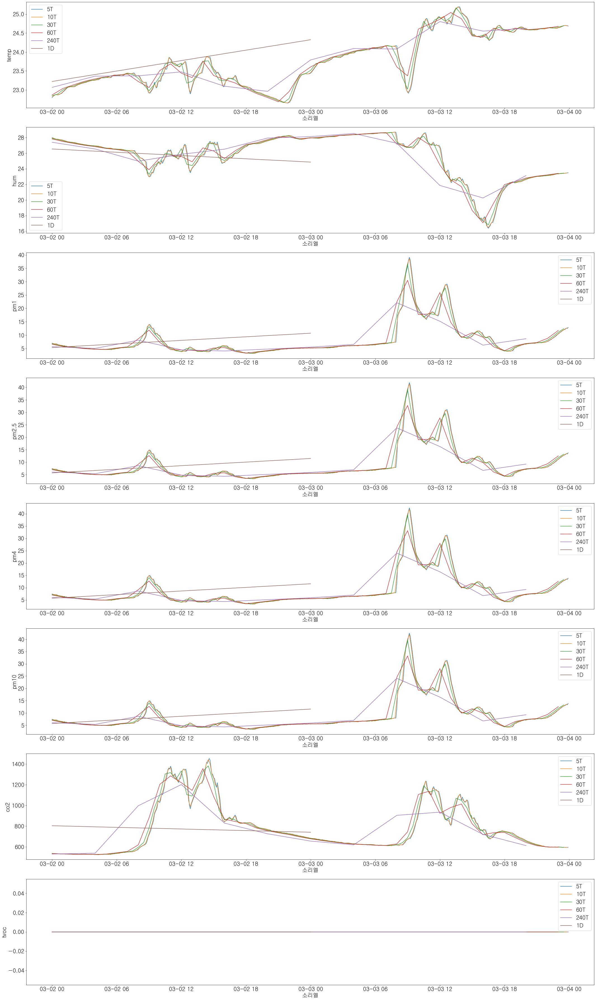

In [182]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '소리엘'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-3']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 1.67 s


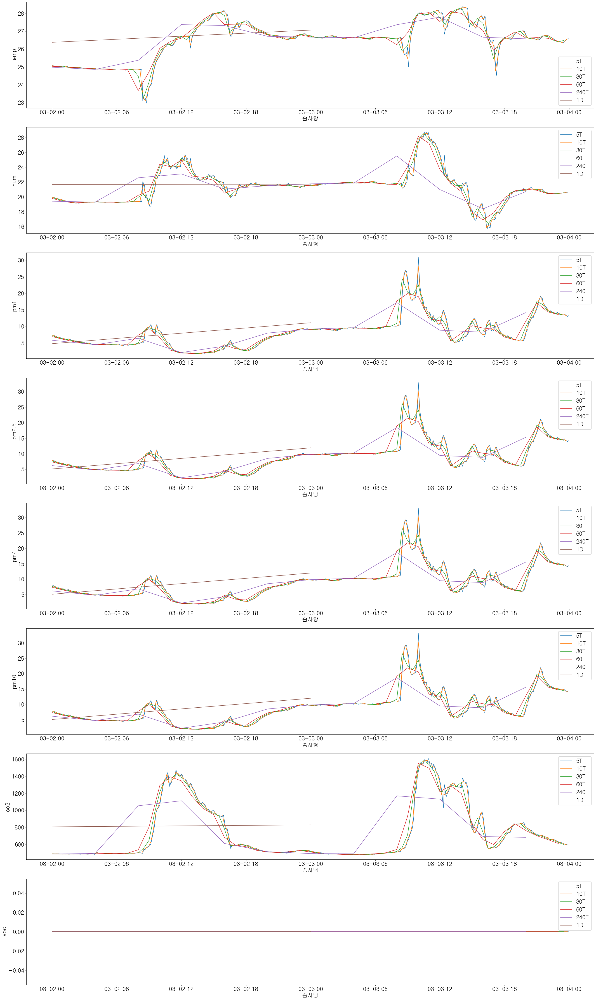

In [183]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-3']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


Wall time: 2.15 s


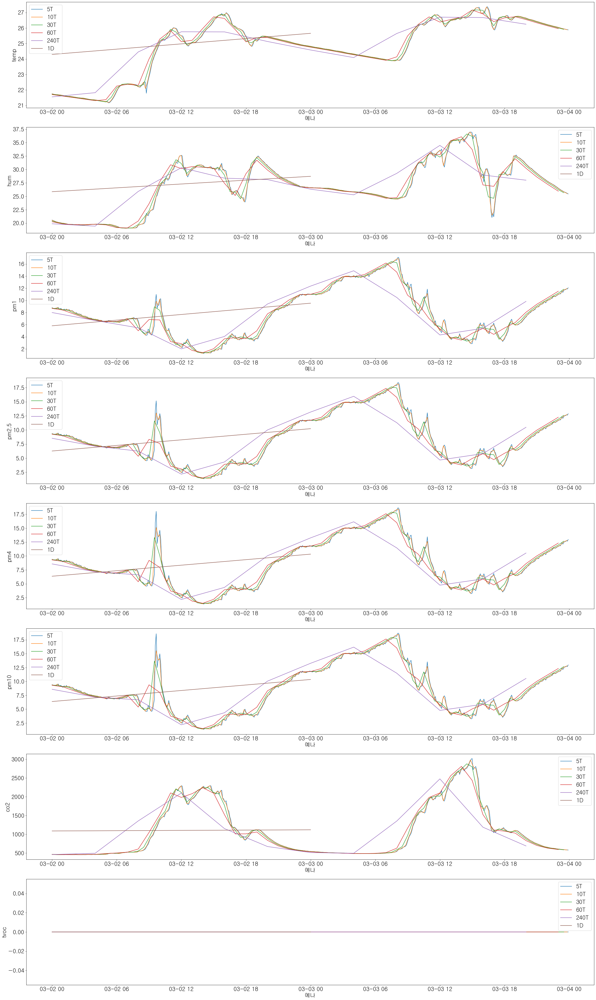

In [184]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '예나'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-3']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


* ACF, PACF

In [186]:
import statsmodels.graphics.tsaplots as sgt

864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
864
432
144
72
18
3
Wall time: 2.31 s


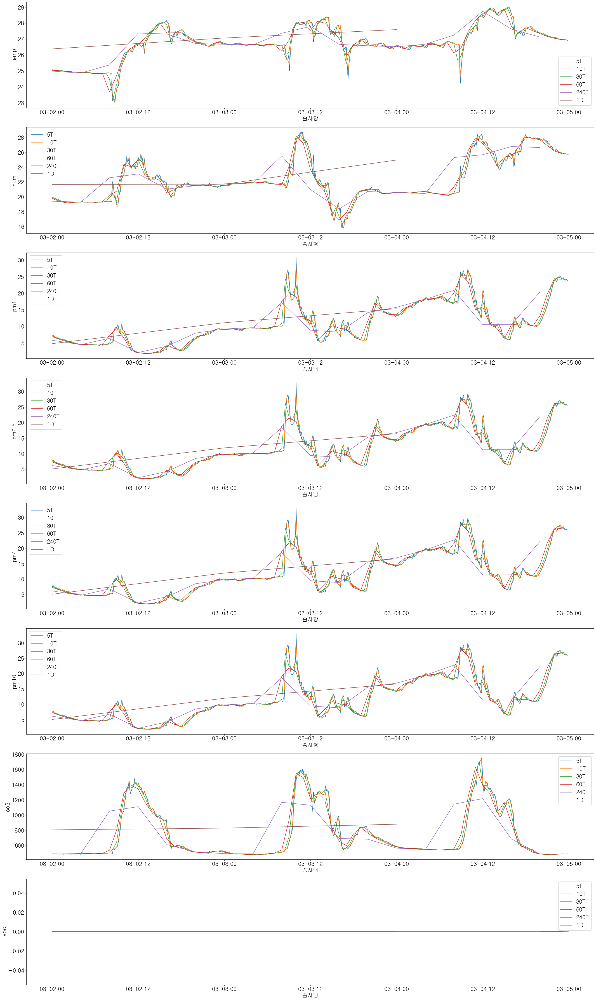

In [253]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T','10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-4']

for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val,).mean()
        print(len(series_data))
        axes[j].plot(series_data, label = val)
        axes[j].set_ylabel(j_val)
        axes[j].legend()
        axes[j].set_xlabel(site)
fig.tight_layout()


C:\Users\Go\miniconda3\envs\pro1\lib\site-packages\statsmodels\tsa\stattools.py:681: RuntimeWarning: invalid value encountered in true_divide
  acf = avf[: nlags + 1] / avf[0]
C:\Users\Go\miniconda3\envs\pro1\lib\site-packages\matplotlib\axes\_base.py:2475: UserWarning: Warning: converting a masked element to nan.
  xys = np.asarray(xys)


Wall time: 819 ms


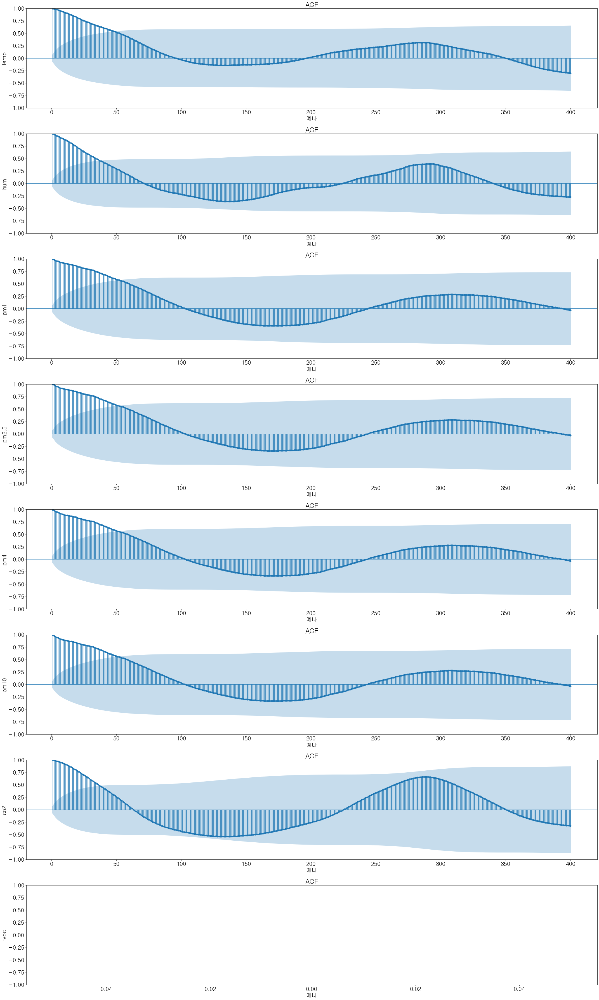

In [ ]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T'],#'10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-4']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val[0],).mean()
        # axes[j].plot(series_data, label = val)
        sgt.plot_acf(series_data,lags=350,ax=axes[j],zero=False)
        axes[j].set_ylabel(j_val)
        # axes[j].legend()
        axes[j].set_xlabel(site)
        axes[j].set_title("ACF")
fig.tight_layout()


C:\Users\Go\miniconda3\envs\pro1\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,
C:\Users\Go\miniconda3\envs\pro1\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,
C:\Users\Go\miniconda3\envs\pro1\lib\site-packages\statsmodels\graphics\tsaplots.py:353: FutureWarning: The default method 'yw' can produce PACF values outside of the [-1,1] interval. After 0.13, the default will change tounadjusted Yule-Walker ('ywm'). You can use this method now by setting method='ywm'.
  FutureWarning,
C:\Users\Go\miniconda3\envs\

LinAlgError: Singular matrix

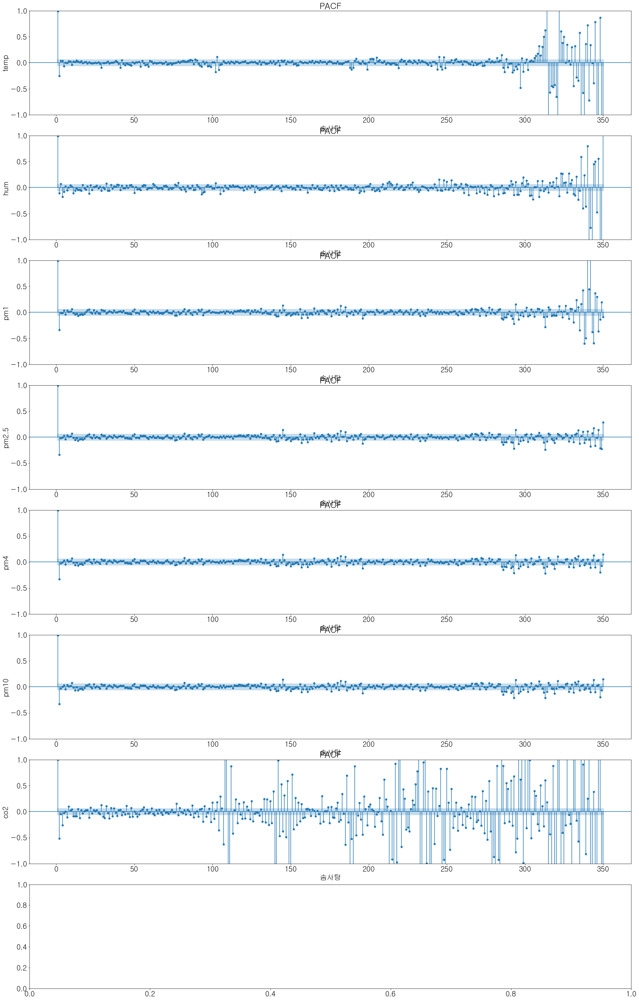

In [250]:
%%time
fig, axes = plt.subplots(len(data.columns)-2,1, figsize=(30,50))
# mean_by_date.loc[:,val].plot()
plt.rc('font', size=20)        # 기본 폰트 크기
plt.rc('axes', labelsize=20)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=20)  # x축 눈금 폰트 크기 
plt.rc('ytick', labelsize=20)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=20)  # 범례 폰트 크기
plt.rc('figure', titlesize=20)


site = '솜사탕'  #['남부', '동화나라', '소리엘', '솜사탕', '예나']
timeleg_list = ['5T'],#'10T','30T','60T','240T','1D',]


period_data = data.loc['2022-03-02':'2022-03-4']
for j,j_val in enumerate(data.columns[:-2]):
    for i, val in enumerate(timeleg_list):
        series_data = period_data[period_data.site == site][[j_val]].resample(val[0],).mean()
        # axes[j].plot(series_data, label = val)
        sgt.plot_pacf(series_data,lags=350,ax=axes[j],zero=False)
        axes[j].set_ylabel(j_val)
        # axes[j].legend()
        axes[j].set_xlabel(site)
        axes[j].set_title("PACF")
fig.tight_layout()
